<a href="https://colab.research.google.com/github/mahi97/socialcomputing/blob/main/SC.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install parsivar
!pip install hazm
!pip install PersianStemmer
!pip install nltk
!pip install pandas==1.3.3
!pip install arabic_reshaper
!pip install python-bidi

     |████████████████████████████████| 36.2 MB 308 kB/s 
     |████████████████████████████████| 1.5 MB 41.3 MB/s 
  Created wheel for parsivar: filename=parsivar-0.2.3-py3-none-any.whl size=36492971 sha256=323d2a716032595c66ffb9a10d513fb593dbcd0a516edf62afedfd8ac9562aaa
  Stored in directory: /root/.cache/pip/wheels/ae/67/7a/49cbf08f64d3f76a26eceaf0e481a40e233f05d4356875cbed
  Created wheel for nltk: filename=nltk-3.4.5-py3-none-any.whl size=1449922 sha256=98c0f135447b34a3831b1d704c36e08fa8fd026b68e82e0367eb3313bf97a8c1
  Stored in directory: /root/.cache/pip/wheels/48/8b/7f/473521e0c731c6566d631b281f323842bbda9bd819eb9a3ead
Successfully built parsivar nltk
  Attempting uninstall: nltk
    Found existing installation: nltk 3.2.5
    Uninstalling nltk-3.2.5:
      Successfully uninstalled nltk-3.2.5
     |████████████████████████████████| 316 kB 4.4 MB/s 
     |████████████████████████████████| 233 kB 38.6 MB/s 
     |████████████████████████████████| 1.4 MB 48.1 MB/s 
  Created wheel

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

from google.colab import data_table
data_table.enable_dataframe_formatter()

Mounted at /content/drive


In [ ]:
import os
os.getcwd()

'/content'

In [ ]:
BASE_DIR = './drive/MyDrive/SC/Data2/'
TWIT_DIR = BASE_DIR + 'tweet/tweet/'
USER_DIR = BASE_DIR + 'user/'

In [ ]:
import os
from bs4 import BeautifulSoup
import pandas as pd
from pprint import pprint
import re
import numpy as np
import matplotlib.pyplot as plt
import random
import functools
import operator
import json
from tqdm import tqdm
pd.set_option('display.max_colwidth', -1)
from nltk.corpus import stopwords
import nltk
nltk.download('stopwords')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:13: FutureWarning: Passing a negative integer is deprecated in version 1.0 and will not be supported in future version. Instead, use None to not limit the column width.
  del sys.path[0]


[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [ ]:
f = open('./drive/MyDrive/SC/out1.txt', 'r')
l = []
for j in tqdm(f.readlines()):
  try:
    l.append(json.loads(j)['raw_data'])
  except ValueError:
    continue
print(len(l))

In [ ]:
df = pd.json_normalize(l[:10_000])
# del l

In [ ]:
df

In [ ]:
dfs = []
for file in os.listdir(TWIT_DIR):
    f = open(TWIT_DIR + file, 'r')
    raw_data = json.load(f)['raw_data']
    dfs.append(pd.json_normalize(raw_data))

df = pd.concat(dfs)

In [ ]:
df

In [ ]:
from bs4 import BeautifulSoup
def remove_tags_and_scripts(text):
    soup = BeautifulSoup(text)
    [script.extract() for script in soup("script")]
    return BeautifulSoup(soup.get_text(), 'lxml').get_text()

In [ ]:
df['content'] = df['full_text']
df['mid'] = range(0,len(df))
df['content'] = df['content'].apply(remove_tags_and_scripts)
df['content'].replace(r'[؛:{}.,;#@!$%^&*!٬٫﷼٪×،*…»«-]', ' ', regex = True, inplace = True)
df['content'].replace(r'[\u200c\u061c]', ' ', regex = True, inplace = True)
df['content'].replace(r'\s', ' ', regex = True, inplace = True)
df['created_at'] = pd.to_datetime(df['created_at'])
df['daykey'] = df.created_at.dt.date

## Removing Stop Words

In [ ]:
stops = open('/content/drive/My Drive/IR/stopwords.txt').read().split('\n')
df['words'] = df['content'].str.split(' ').apply(lambda x: [word for word in x 
                                                            if word not in stops 
                                                            and not word.startswith('co/') 
                                                            and word not in stopwords.words()]).dropna()

In [ ]:
df

NameError: ignored

## Save for Future

In [ ]:
# df = df.set_index(df.mid)
# df['created_at'] = pd.to_datetime(df['created_at'])
# df['daykey'] = df.created_at.dt.date

df.to_pickle('/content/drive/MyDrive/SC/df_FA2.pkl')
# df.to_csv('df_FA.csv')

# Load

In [ ]:
# df = pd.read_csv('/content/drive/MyDrive/SC/df.csv')
df = pd.read_pickle('/content/drive/MyDrive/SC/df_FA2.pkl')
df = df.drop([c for c in list(df.columns) if c.startswith('card')], axis=1)

# df = pd.read_pickle('/content/drive/MyDrive/SC/df2.pkl')

In [ ]:
df[['created_at',
 'id',
 'full_text',
 'source',
 'user_id',
 'geo',
 'coordinates',
 'place',
 'contributors',
 'is_quote_status',
 'retweet_count',
 'favorite_count',
 'reply_count',
 'quote_count',
 'lang',
 'supplemental_language']]

,created_at,id,full_text,source,user_id,geo,coordinates,place,contributors,is_quote_status,retweet_count,favorite_count,reply_count,quote_count,lang,supplemental_language
mid,,,,,,,,,,,,,,,,
0,2021-07-09 14:44:23+00:00,1413509341743779846,اول آخر کسی که از طالبان دفاع می‌کنه گه بگیره..\nیه مشت تروریست وحشی بی شرف ...\nهنوز دهه هفتاد و هشتاد ..اون همه وحشی گری و قتل و عام و خفقان برای ملت افغان فراموش نشده...\nحمله به کنسولگری ایران ...\nبامیان و ...\nبعد یه مشت دیوس راه افتادن از تغییر رفتار این زنا زاده ها ! میگن....,"<a href=""http://twitter.com/download/android"" rel=""nofollow"">Twitter for Android</a>",1380635931976286212,None,None,None,None,False,0,3,0,0,fa,None
1,2021-07-15 11:35:22+00:00,1415636101054832640,جگرگوشه‌های شان برای دفاع از بامیان در برابر طالبان می‌رزمند و مادران و خواهران آن‌ها برای‌شان نان و غذا آماده می‌کنند. بامیان همان‌گونه که در عرصه‌‌ی تظاهرات و فعالیت‌های مدنی الگو است در زمینه‌ی مقاومت و جنگ برای دفاع از خانه و سرزمین نیز الگو است. \n#ايستادگى_براى_بقا https://t.co/bdKXPHr80j,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",884525585501966336,None,None,NaN,None,False,8,59,2,0,fa,None
2,2021-03-23 10:24:11+00:00,1374305970273325058,@FaisalNawabi3 تو در بهسود نیستی و زندگی نمی کنی پس نمی دانی که چرا مردم از علیپور حمایت میکنند. کاش نیروهای امنیتی در جلریز امنیت مردم را تامین کنند که به علیپوری نیاز نباشد. آیا از خود پرسیده ای که چرا در بامیان و دایکندی و سایر مناق هزاره جات گروپ مسلح وجود نداره؟,"<a href=""https://mobile.twitter.com"" rel=""nofollow"">Twitter Web App</a>",988303780801376256,None,None,None,None,False,0,1,0,0,fa,None
3,2020-11-07 10:38:43+00:00,1325024877011726337,ولسوال نام‌نهاد گروه طالبان برای ولسوالی شیبر کشته شد\n\nامیر شریف ولسوال شیبر ولایت بامیان می‌گوید، ولسوال نام‌نهاد طالبان برای این ولسوالی از سوی باشنده‌گان ساحه‌ی «برفک» این ولسوالی کشته شده است. https://t.co/bZpYQbTDq0,"<a href=""http://twitter.com/download/android"" rel=""nofollow"">Twitter for Android</a>",1283005151163428865,None,None,None,None,False,0,10,2,0,fa,None
4,2021-07-18 18:38:49+00:00,1416829827898871816,ولایت بامیان\nفرستنده: علی‌دوست نوازش \nشما نیز می‌توانید عکس‌هایی را که از مناظر زیبای افغانستان گرفته اید در پیامگیر این صفحه بفرستید تا آن را با دیگر خوانندگان شریک سازیم.\n#Afghanistan #nature #NaturePhotography #mountains #Village #photography #voadari https://t.co/Q9heSYYU79,"<a href=""https://mobile.twitter.com"" rel=""nofollow"">Twitter Web App</a>",47597891,None,None,None,None,False,3,41,0,0,fa,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18487,2021-07-15 01:20:22+00:00,1415481329827950594,@SaliheIbrahim بعد از جنایت و‌کشتار طالبان در ۲دهه قبل در #بامیان دیگه مردم اون سرزمین اجازه نمیده خاکش زیر پای طالبان بیفته،\nو جنایت ها تکرار بشه.\nان شاالله پیروز میدان هستین،\nموفق باشین,"<a href=""http://twitter.com/download/android"" rel=""nofollow"">Twitter for Android</a>",1139299847159369729,None,None,None,None,False,0,1,0,0,fa,None
18488,2020-11-25 08:15:43+00:00,1331511874668687360,@AFPWN این همه بد بختی و بیچارگی و ظلمی که به سر مردم هزاره ها میایند باید جواب گویش رهبرها باشند وگرنه مردم خودش شان کاری خواهند کرد که تصور اش را حتی نخواهند کرد\nبامیان #,"<a href=""http://twitter.com/download/android"" rel=""nofollow"">Twitter for Android</a>",838704439045271553,None,None,None,None,False,0,0,0,0,fa,None
18489,2020-12-24 10:03:31+00:00,1342048252020092928,تصاویر از رقابت‌های جام پولیس بایسکل رانی در کابل...!\n۲۶ بانو از ولایات غزنی ،بامیان،فاریاب و کابل به هدف حمایت از نیروهای امنیتی کشور به رقابت پرداختند.\n#RTASport https://t.co/FCr6znVJte,"<a href=""https://mobile.twitter.com"" rel=""nofollow"">Twitter Web App</a>",1127485465232388096,None,None,None,None,False,1,14,0,0,fa,None


In [ ]:
list(df.columns)
['created_at',
 'id',
 'full_text',
 'source',
 'user_id',
 'geo',
 'coordinates',
 'place',
 'contributors',
 'is_quote_status',
 'retweet_count',
 'favorite_count',
 'reply_count',
 'quote_count',
 'lang',
 'supplemental_language',
 'entities.hashtags',
 'entities.symbols',
 'entities.user_mentions',
 'entities.urls',
 'possibly_sensitive',
 'possibly_sensitive_editable',
 'place.place_type',
 'place.name',
 'place.full_name',
 'place.country',
 'place.contained_within',
 'place.bounding_box.type',
 'place.bounding_box.coordinates',
 'withheld_in_countries',
 'conversation_control.policy',
 'conversation_control.conversation_owner.screen_name',
 'geo.type',
 'geo.coordinates',
 'coordinates.type',
 'coordinates.coordinates',
 'words']

['created_at',
 'id',
 'full_text',
 'source',
 'user_id',
 'geo',
 'coordinates',
 'place',
 'contributors',
 'is_quote_status',
 'retweet_count',
 'favorite_count',
 'reply_count',
 'quote_count',
 'lang',
 'supplemental_language',
 'geo.type',
 'geo.coordinates',
 'coordinates.type',
 'coordinates.coordinates',
 'words']

## INDEX

In [ ]:
class IndexMaker:
    def __init__(self):
        self.dictionary = {}
        self.sorted_dictionary = []
        self.inverted_index = {}
        self.new_words = [[],[]]
        self.cnt = 0

    def add_cnt(self, i, w):
        self.dictionary[w] = self.dictionary[w] + 1 if w in self.dictionary.keys() else 1
        h_w = hash(w)
        if h_w in self.inverted_index.keys():
            self.inverted_index[h_w].add(i)
        else:
            self.cnt += 1
            self.inverted_index[h_w] = set([i])
    
    def add_to_dict(self, row):
        i = row.mid
        wordlist = row.words
        self.cnt = 0
        [self.add_cnt(i, w) for w in wordlist]
        self.new_words[0].append(self.cnt)
        self.new_words[1].append(len(wordlist))
    
    # Sort a dictionary of word-frequency pairs in
    # order of descending frequency.
    def sortFreqDict(self):
        self.sorted_dictionary = [(self.dictionary[key], key) for key in self.dictionary]
        self.sorted_dictionary.sort()
        self.sorted_dictionary.reverse()
        
    def get_word(self, word):
        return self.inverted_index[hash(word)]

    def run(self, _df):
        _df.apply(self.add_to_dict, axis=1)
        self.sortFreqDict()
        return self.dictionary, self.sorted_dictionary, self.inverted_index, self.new_words

In [ ]:
ind = IndexMaker()
dictionary, sorted_dict, inverted_index, new_words = ind.run(df)

In [ ]:
sum([len(i) for i in inverted_index.values()])

276356

In [ ]:
select = 2
word_and_freq = sorted_dict[select]
print('The word in place {} of dictionary'.format(select), word_and_freq)
print('Number of Files found in inverted index for the word {} is:'.format(word_and_freq[1]), len(ind.get_word(word_and_freq[1])))

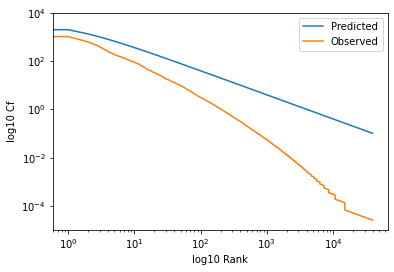

In [ ]:


def zipf(sorted_dict):
    plt.yscale('log')
    plt.xscale('log')
    plt.xlabel('log10 Rank')
    plt.ylabel('log10 Cf')
    K = sorted_dict[0][0]
    plt.plot([K/y for y in range(1,len(sorted_dict))], label='Predicted')
    plt.plot([x[0]/(i+1) for i, x in enumerate(sorted_dict)], label='Observed')
    plt.legend()

zipf(sorted_dict)

In [ ]:


def flattern(a):
    return functools.reduce(operator.iconcat, a, [])

def heaps(df, col, t1, t2, new_words):
    sample_5T = flattern([df[df.mid == i][col].to_list()[0] for i in random.sample(range(len(df)), t1)])
    sample_15T = flattern([df[df.mid == i][col].to_list()[0] for i in random.sample(range(len(df)), t2)])
    M_5T = len(set(sample_5T))
    T_5T = len(sample_5T)
    M_15T = len(set(sample_15T))
    T_15T = len(sample_15T)

    b = (np.log10(M_15T) - np.log10(M_5T)) / (np.log10(T_15T) - np.log10(T_5T))
    k = M_5T / T_5T ** b
    print(k,b)

    plt.yscale('log')
    plt.xscale('log')
    plt.xlabel('log10T')
    plt.ylabel('log10M')
    plt.plot(range(new_words[1][0],sum(new_words[1])), [k*(i**b) for i in range(new_words[1][0],sum(new_words[1]))], label='Predicted')
    plt.plot(np.cumsum(new_words[1]), np.cumsum(new_words[0]), label='Observed')
    plt.legend()



14.680057816177559 0.6256423989029433


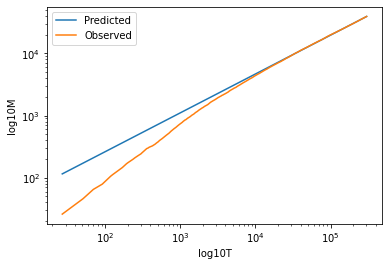

In [ ]:
heaps(df, 'words', 5000, 15000, new_words)

In [ ]:
all_chars = set()
df.content.apply(lambda x : [all_chars.add(s) for s in x])
print(len(all_chars))
print(all_chars)

152
{'ث', 'ظ', 'ؓ', 'θ', 'ڊ', 'س', 'd', 'f', 'q', 'پ', '6', 'ο', 'آ', 'с', 'τ', 'ڏ', '🧿', 'ࣿ', 'φ', 'χ', 'ح', 'ض', 'ا', 'ن', 'ب', 'h', 'z', 'n', '🤓', '🆗', 'w', 'ś', 'ط', 'ω', 'ج', '\U0001f7e2', ' ', '3', 'ä', 'г', 'چ', 'غ', 'ε', 'ه', 'i', 'κ', 'ع', '5', 'ت', '̅', '2', 'ﺉ', '4', 'υ', 'c', 'ۉ', 'γ', 'ڄ', '؍', 'ς', 'н', 'ر', 't', 'r', 'а', 'a', '9', 'ٶ', 'à', 'ڌ', 'k', '🆔', 'ز', 'خ', 'ٕ', '_', 's', 'o', 'ί', 'ф', '\U0001f7e1', 'т', '̇', 'ی', 'ذ', 'p', 'ل', 'ق', 'x', 'b', '）', '~', '（', '8', 'σ', '\U0001fa81', 'د', '1', 'ρ', 'گ', 'ص', '🧐', 'و', 'ٻ', 'l', 'ف', '🤐', 'ή', 'ν', 'ۓ', 'έ', '0', 'ۃ', 'δ', '7', 'ش', 'ٙ', 'ڃ', '🧡', '\U0001fa78', 'v', 'ؔ', 'ژ', 'ؑ', '۾', 'y', 'ک', 'g', 'ڇ', 'η', 'μ', 'λ', 'u', 'ٿ', 'م', '\U0001f9be', 'ά', 'ڻ', 'ζ', 'ؒ', 'α', 'ι', 'ڀ', 'j', '۽', 'm', 'ڪ', 'и', 'ﷻ', 'π', 'e', 'β'}


In [ ]:
emoji_pattern = re.compile("["
        u"\U0001F600-\U0001F64F"  # emoticons
        u"\U0001F300-\U0001F5FF"  # symbols & pictographs
        u"\U0001F680-\U0001F6FF"  # transport & map symbols
        u"\U0001F1E0-\U0001F1FF"  # flags (iOS)
        u"\U0001F914-\U0001F9B0"  # Tweeter
                           "]+", flags=re.UNICODE)
df.content.replace(emoji_pattern, ' ', regex = True, inplace = True)
df.content.replace(r'[\'\"\"()+/<=>?\[\]\\`|©¬°±·¼：�]', ' ', regex = True, inplace = True)
df.content.replace(r'[﴾﴿ˈ˝ϕ؟ًٌٍَُِّْٖٓٔٗٞ٭ٰۖۗۙۚۡۢۤۥ]', ' ', regex = True, inplace = True)
df.content.replace(r'['
                   '\x7f-\xad'
                   '\u200b-\uf1d8'
                   '\ufeff'
                   '\ufe0f'
                   '\ufffc'
                   '\u06e6'
                   '\u061c'
                   '\u06ed'
                   '\u092f-\u1e25'
                   '\u0928'
                   '\u092c'
                   '\u092e'
                   '\ufdfa'
                   '\u06d4'
                   '\U0001f19a'
                   '\U0001f90d'
                   '\U0001f9c5'
                   '\U0001f9ce'
                   '\U0001f9d7'
                   '\U0001fab4'
                   '\U0001fad0'
                   ']', ' ', regex = True, inplace = True)

In [ ]:
mapper = []
mapper.append(('و', 'ﻮﻭؤوۆ'))
mapper.append(('ه','ﺓﻫﻪﻩةﻬھۀهہە'))
mapper.append(('ن','ڼںﻨﻧﻦﻥنﺬ'))
mapper.append(('م','ﻤﻣﻢﻡم'))
mapper.append(('ل','ڵﻞﻠﻟﻝل'))
mapper.append(('ک','ګﻜﻛﻚكﮑﮐﮏک'))
mapper.append(('ق','ﻗﻘﻖق'))
mapper.append(('ف','ﻓﻒﻑﻔف'))
mapper.append(('غ','ﻐﻏغ'))
mapper.append(('ع','ﻋﻉﻊﻌع'))
mapper.append(('ط','ﻃﻂﻄط'))
mapper.append(('ض','ﺿﻀﺽض'))
mapper.append(('ص','ﺻﺼﺹص'))
mapper.append(('ش','ﺸﺷﺶﺵشݭ'))
mapper.append(('س','ښﺴﺳﺱﺲس'))
mapper.append(('ز','ﺰزﺯ'))
mapper.append(('ر','ڕږړڑﺮﺭر'))
mapper.append(('د','ډڈﺪﺩد'))
mapper.append(('خ','ﺧﺨﺦخ'))
mapper.append(('ح','ﺢﺣﺤح'))
mapper.append(('لا', 'ﻼﻻ'))
mapper.append(('ی','ﺋﻯﺌﻱﻲﻰﻳﻴئىيﯿﯾﯽﯼیے'))
mapper.append(('ج','ﺠﺞﺟج'))
mapper.append(('ث','ﺛث'))
mapper.append(('ت','ټٹﺘﺖﺕﺗت'))
mapper.append(('ب','ﺒﺑﺐﺏ'))
mapper.append(('ا','ﺎﺄﺍأإاٱٲ'))
mapper.append(('آ','ﺁآ'))
mapper.append(('','ﺀـء'))
mapper.append(('الله','ﷲ'))
mapper.append(('ریال', '﷼'))
mapper.append(('ب','ب'))
mapper.append(('ذ','ذ'))
mapper.append(('ظ','ظﻈ'))
mapper.append(('گ','ﮕﮔﮓﮒگ'))
mapper.append(('ژ','ﮋژ'))
mapper.append(('چ','څځﭽچﭼ'))
mapper.append(('پ','ﭙﭘﭗپ'))
mapper.append(('ی','ۍێېٸ'))
mapper.append(('C','Ç'))
mapper.append(('E','É'))
mapper.append(('U','Ü'))
mapper.append(('a','áãāæâå'))
mapper.append(('c','çč'))
mapper.append(('e','èēé'))
mapper.append(('i','íıî'))
mapper.append(('o','óöøôō'))
mapper.append(('u','úü'))
mapper.append(('g','ğǧ'))
mapper.append(('z','ž'))
mapper.append(('s','şš'))
mapper.append(('0','٠۰'))
mapper.append(('1','١۱'))
mapper.append(('2','٢۲'))
mapper.append(('3','٣۳'))
mapper.append(('4','٤۴'))
mapper.append(('5','٥۵'))
mapper.append(('6','٦۶'))
mapper.append(('7','٧۷'))
mapper.append(('8','٨۸'))
mapper.append(('9','٩۹'))
mapper.append((' ','_'))

[df.content.replace(r'[{}]'.format(m[1]), m[0], regex = True, inplace = True) for m in mapper]
df.content = df.content.apply(lambda x : x.lower())
# df.content.replace(r'[0-9]', '', regex = True, inplace = True)

print(len(mapper))

62


In [ ]:
chars = set()
df.content.apply(lambda x : [chars.add(s) for s in x])
print(len(chars))

151


In [ ]:
l = list(zip(chars,[c.encode("unicode_escape") for c in chars]))
l.sort()
pprint(l)

[(' ', b' '),
 ('0', b'0'),
 ('1', b'1'),
 ('2', b'2'),
 ('3', b'3'),
 ('4', b'4'),
 ('5', b'5'),
 ('6', b'6'),
 ('7', b'7'),
 ('8', b'8'),
 ('9', b'9'),
 ('a', b'a'),
 ('b', b'b'),
 ('c', b'c'),
 ('d', b'd'),
 ('e', b'e'),
 ('f', b'f'),
 ('g', b'g'),
 ('h', b'h'),
 ('i', b'i'),
 ('j', b'j'),
 ('k', b'k'),
 ('l', b'l'),
 ('m', b'm'),
 ('n', b'n'),
 ('o', b'o'),
 ('p', b'p'),
 ('q', b'q'),
 ('r', b'r'),
 ('s', b's'),
 ('t', b't'),
 ('u', b'u'),
 ('v', b'v'),
 ('w', b'w'),
 ('x', b'x'),
 ('y', b'y'),
 ('z', b'z'),
 ('~', b'~'),
 ('à', b'\\xe0'),
 ('ä', b'\\xe4'),
 ('ś', b'\\u015b'),
 ('̅', b'\\u0305'),
 ('̇', b'\\u0307'),
 ('ά', b'\\u03ac'),
 ('έ', b'\\u03ad'),
 ('ή', b'\\u03ae'),
 ('ί', b'\\u03af'),
 ('α', b'\\u03b1'),
 ('β', b'\\u03b2'),
 ('γ', b'\\u03b3'),
 ('δ', b'\\u03b4'),
 ('ε', b'\\u03b5'),
 ('ζ', b'\\u03b6'),
 ('η', b'\\u03b7'),
 ('θ', b'\\u03b8'),
 ('ι', b'\\u03b9'),
 ('κ', b'\\u03ba'),
 ('λ', b'\\u03bb'),
 ('μ', b'\\u03bc'),
 ('ν', b'\\u03bd'),
 ('ο', b'\\u03bf'),
 ('π', b'\\u

In [ ]:


def seperate_num_chars(text):
    match = re.match(r"([a-zA-Z]+)([\u0600-\u06FF]+)", text, re.I) # First Latin then Persian
    if match:
        return match.groups()
    match = re.match(r"([\u0600-\u06FF]+)([a-zA-Z]+)", text, re.I) # First Persian then Latin
    if match:
        return match.groups()
    match = re.match(r"([a-zA-Z\u0600-\u06FF]+)([0-9]+)", text, re.I) # First Chars then Numbers
    if match:
        return match.groups()
    match = re.match(r"([0-9]+)([a-zA-Z\u0600-\u06FF]+)", text, re.I) # First Numbers then Chars
    if match:
        return match.groups()
    return text

def join_persian_expr(text):
    expr = open('/content/drive/My Drive/IR/expressions.txt').read().split('\n')
    expr2 = [e.replace(' ', '_') for e in expr]
    for e, e2 in list(zip(expr, expr2)):
        text = text.replace(e, e2)
    return text



In [ ]:
print(join_persian_expr('بنا بر این'))

بنا_بر_این


In [ ]:
from __future__ import unicode_literals
from PersianStemmer import PersianStemmer 
import parsivar
import hazm
ps = PersianStemmer()
my_stemmer = parsivar.FindStems()

df.content = df.content.apply(join_persian_expr)
token_hazm = df.content.apply(hazm.word_tokenize)
token_hazm = token_hazm.apply(lambda x : [seperate_num_chars(w) for w in x])
token_hazm.apply(lambda x : [x.extend(w) for w in x if isinstance(w, tuple)])

# stemmed_persian = token_hazm.apply(lambda x : [ps.run(w) for w in x if not isinstance(w, tuple)]) # For Words
# stemmed_parsivar = stemmed_persian.apply(lambda x : [my_stemmer.convert_to_stem(w) for w in x if not isinstance(w, tuple)]) # For verbs

mid
0        []    
1        []    
2        [None]
3        [None]
4        [None]
          ...  
18487    [None]
18488    []    
18489    [None]
18490    []    
18491    []    
Name: content, Length: 18492, dtype: object

In [ ]:
## FOR REPORT
## گفت، گو، رود، رو، خواه، سپاس، هنر، شریف، دوست، یاد، توان، شنو، کرد، ساز، دان،

the_list_1 = ['گفت', 'گو', 'رود', 'رو', 'خواه', 'سپاس', 'هنر', 'شریف', 'دوست', 'یاد', 'توان', 'شنو', 'کرد', 'ساز', 'دان']
the_list_2 = ['گفت&گو', 'رود&رو', 'خواستن&خواه', 'توانستن&توان', 'شنیدن&شنو', 'کرد&کن', 'ساخت&ساز', 'دانستن&دان']
the_list_2.extend(the_list_1)
found = {}
def stem_1(ps, word):
    w = ps.run(word)
    if w in the_list_1:
      if w in found.keys():
        found[w].add(word)
      else:
        found[w] = set([word])
    return w
 
def stem_2(my_stemmer, word):
    w = my_stemmer.convert_to_stem(word)
    if w in the_list_2:
      if w in found.keys():
        found[w].add(word)
      else:
        found[w] = set([word])
    return w

stemmed_persian = token_hazm.apply(lambda x : [stem_1(ps, w) for w in x if not isinstance(w, tuple)]) # For Words
stemmed_parsivar = stemmed_persian.apply(lambda x : [stem_2(my_stemmer, w) for w in x if not isinstance(w, tuple)]) # For verbs

print(found)

{'دان': {'دانست', 'دانت', 'دان', 'دانم', 'دانی', 'دانان', 'دانند'}, 'شریف': {'شریف', 'شریفی', 'شریفیم'}, 'دوست': {'دوستانی', 'دوستانتان', 'دوستای', 'دوستش', 'دوستات', 'دوستان', 'دوستم', 'دوستت', 'دوستهای', 'دوست', 'دوستانش', 'دوستتان', 'دوستانم'}, 'ساز': {'ساز', 'سازهای', 'سازست', 'سازند', 'سازم', 'سازیهای', 'بازساز', 'سازی'}, 'یاد': {'یاد', 'یادیی', 'یادمان', 'یادتان', 'یادشان', 'یادها', 'یادش', 'یادم', 'یادی', 'یادین', 'یادت'}, 'کرد': {'کردی', 'کرد', 'کردند', 'کردین', 'کردم', 'کردهای'}, 'گفت': {'گفتین', 'گفت', 'گفتگی'}, 'رو': {'فرارو', 'بیروی', 'وارو', 'رو', 'روست'}, 'گو': {'گوت', 'بیگو', 'گو', 'گوهای', 'گوای'}, 'توان': {'توانند', 'توانست', 'توان'}, 'هنر': {'هنرهای', 'هنریار', 'هنر', 'هنرکده'}, 'رود': {'رود', 'رودی'}, 'سپاس': {'سپاس'}, 'خواه': {'خواه'}, 'کرد&کن': {'نکنیم', 'نکردیم', 'میکنند', 'کنیم', 'نمیکنید', 'نکنند', 'نمیکنند', 'میکردند', 'کردید', 'نکنم', 'نمیکردیم', 'میکنم', 'نکنی', 'میکردی', 'میکردم', 'کنم', 'کنند', 'نکردید', 'کنید', 'نکردی', 'بکنم', 'نمیکنی', 'کردیم', 'بکنید', 

In [ ]:
def histogram(hist, bins='auto', unique=True):
    if len(hist):
        print('MIN MAX MEDIAN MEAN STD LEN')
        print(min(hist), max(hist), np.median(hist), np.mean(hist), np.std(hist), len(hist))
        _ = plt.hist(hist, bins=bins)  # arguments are passed to np.histogram
        plt.title("Histogram with {} bins".format(bins))
        plt.show()

In [ ]:
df[df.favorite_count == 0].count()

created_at    4997
id            4997
id_str        4997
full_text     4997
truncated     4997
              ... 
content       4997
mid           4997
words         4997
stem          4997
daykey        4997
Length: 8145, dtype: int64

MIN MAX MEDIAN MEAN STD LEN
0 22056 0.0 5.461064243997404 194.96357044561094 18492


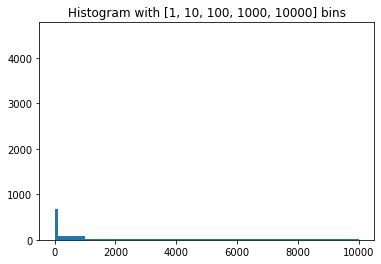

In [ ]:
histogram(list(df[df.retweet_count > -1].retweet_count), bins=[1, 10, 100, 1000, 10000])

MIN MAX MEDIAN MEAN STD LEN
0 119233 2.0 37.80283365779797 948.7738739521648 18492


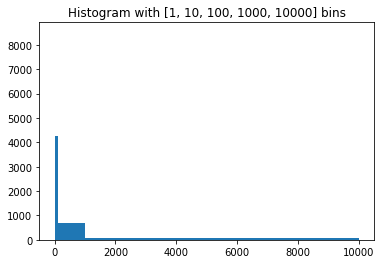

In [ ]:
histogram(list(df[df.favorite_count > -1].favorite_count), bins=[1, 10, 100, 1000, 10000])

In [ ]:
stops = open('/content/drive/My Drive/IR/all.txt').read().split('\n')
stops = [ps.run(my_stemmer.convert_to_stem(w)) for w in stops] # Apply the same stemming changes on stop words ... just in case :D
df['stem'] = df['stem'].apply(lambda x: [word.replace('_', ' ') for word in x])
df['words'] = df['stem'].apply(lambda x: [word for word in x if word not in stops and not word.startswith('co/')])


In [ ]:
ind2 = IndexMaker()
ind2.run(df[df.retweet_count > 1])
freq_words2 = [f[1] for f in ind2.sorted_dictionary[:50]]
freq_cnt2 = [f[0] for f in ind2.sorted_dictionary[:50]]
print(freq_words2)


['طالبان', 'ولسوالی', 'کابل', 'هزاره', 'نیرو', 'والی', 'بودا', 'مین', 'مزار', 'پنجشیر', 'علی', 'امنیتی', 'زیبا', 'دست', 'سیغان', 'دایکندی', 'انفجار', 'هرات', 'تن', 'کهمرد', 'زن', 'in', 'کشور', 'تخریب', 'بهسود', 'ایران', 'امیر', 'الله', 'مجسمه', 'عکس', 'میدان', 'حمله', 'شهید', 'کر', 'طالب', 'مقاومت', 'حکومت', 'پر', 'مجاهد', 'سی', 'گروه', 'تروریست', 'دختر', 'بلخ', 'یی', 'کشید&کش', 'ولایه', 'فتح', 'شده است', 'جان']


In [ ]:
print(freq_words2)


['طالبان', 'ولسوالی', 'کابل', 'هزاره', 'نیرو', 'امنیتی', 'والی', 'بودا', 'انفجار', 'پنجشیر', 'کشور', 'دایکندی', 'هرات', 'زیبا', 'مزار', 'تن', 'دست', 'زن', 'میدان', 'weareafghanistan', 'صلح', 'علی', 'حمله', 'تخریب', 'بلخ', 'سیغان', 'مین', 'کار', 'کهمرد', 'گروه', 'شده است', 'امنیت', 'ایران', 'مجسمه', 'شهید', 'برگزار', 'عکس', 'محلی', 'وردک', 'تروریست', 'زخمی', 'امیر', 'بهسود', 'دختر', 'اسلام', 'پرو', 'وزارت', 'حکومت', 'پر', 'طالب']


In [ ]:
print(freq_words2)
# translate = ['Taliban', 'District', 'Kabul (city)', 'Hazara (city)', 'Governor', 'Panjshir (city)', 'Daikundi (city)', 'Force',
#  'Buddha', 'Herat (city)', 'Explosion', 'Security', 'Mazar (person)', 'Country', 'Hand', 'Square', 'Beautiful',
#   'Mine', 'Body', 'Woman', 'Ali', 'Iran', 'Work','News', 'Balkh (city)', 'Talib', 'Destruction', 'Attack', 'Peace',
#  'Has', 'Security', 'Kahmard (city)', 'Wardak (city)', 'Idol', 'Sighan (city)', 'Sculpture', 'Ghazni (person)', 'Martyr', 'Government',
#  'Behsud (city)', 'Islam', 'Badakhshan (city)', 'Group', 'Local', 'Terrorist', 'Allah (God)', 'Kandahar (city)', 'War', 'Life', 'Thirty']
# print(translate)
# trans = {w: t for w,t in zip(freq_words2, translate)}
# trans



['طالبان', 'ولسوالی', 'کابل', 'هزاره', 'نیرو', 'والی', 'بودا', 'مین', 'مزار', 'پنجشیر', 'علی', 'امنیتی', 'زیبا', 'دست', 'سیغان', 'دایکندی', 'انفجار', 'هرات', 'تن', 'کهمرد', 'زن', 'in', 'کشور', 'تخریب', 'بهسود', 'ایران', 'امیر', 'الله', 'مجسمه', 'عکس', 'میدان', 'حمله', 'شهید', 'کر', 'طالب', 'مقاومت', 'حکومت', 'پر', 'مجاهد', 'سی', 'گروه', 'تروریست', 'دختر', 'بلخ', 'یی', 'کشید&کش', 'ولایه', 'فتح', 'شده است', 'جان']


In [ ]:
freq_words = []
freq_cnt = []
month = []
for i in range(2):
  for j in range(12):
    start = '202' + str(i) + '-' + ('' if j >= 9 else '0') + str(j+1) + '-01'
    ind2 = IndexMaker()
    # print(start)
    # print(df[df.created_at.dt.year == 2020 + i][df.created_at.dt.month == j+1].count())
    ind2.run(df[df.created_at.dt.year == 2020 + i][df.created_at.dt.month == j+1][df.retweet_count > 1])
    # print(ind2.sorted_dictionary[:20])
    if len([f[1] for f in ind2.sorted_dictionary[:10]]) == 0:
      freq_words += ['none' for _ in range(10)]
      freq_cnt += [0 for _ in range(10)]
    freq_words += [f[1] for f in ind2.sorted_dictionary[:10]]
    freq_cnt += [f[0] for f in ind2.sorted_dictionary[:10]]

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  # Remove the CWD from sys.path while we load stuff.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  # Remove the CWD from sys.path while we load stuff.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  # Remove the CWD from sys.path while we load stuff.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  # Remove the CWD from sys.path while we load stuff.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  # Remove the CWD from sys.path while we load stuff.
/usr/local/lib/python3.7/

In [ ]:
190 / 10

19.0

In [ ]:
month = []
[[[month.append(i*12 + j) for _ in range(10)] for j in range(12)] for i in range(2)]
month = month[:len(freq_words)]
len(month), len(freq_words), len(freq_cnt), month[:3]

(233, 233, 233, [0, 0, 0])

In [ ]:
trans['بازداشت'] = 'Arresting'
trans['تاریخی'] = 'Historical'
trans['پنجه'] = 'Five'
trans['کشتار'] = 'Genocide'
trans['بندامیر'] = 'Band Amir (city)'
trans['کتاب'] = 'Book'
trans['هدیه'] = 'Gift'
trans['کاربر'] = 'User'
trans['دوست'] = 'Friend'
trans['یکاولنگ'] = 'Yekavlang (city)'
trans['کنه'] ='Kate'
trans['پور'] = 'Son'
trans['هاشم'] = 'Hashem (name)'
trans['نوشته'] = 'Note'
trans['نظر'] = 'Comment'
trans['علیپور'] = 'Alipour (person)'

NameError: ignored

['کابل', 'دست', 'فرهنگی', 'طالبان', 'ولسوالی', 'زن', 'کابل', 'دایکندی', 'هزاره', 'سره']


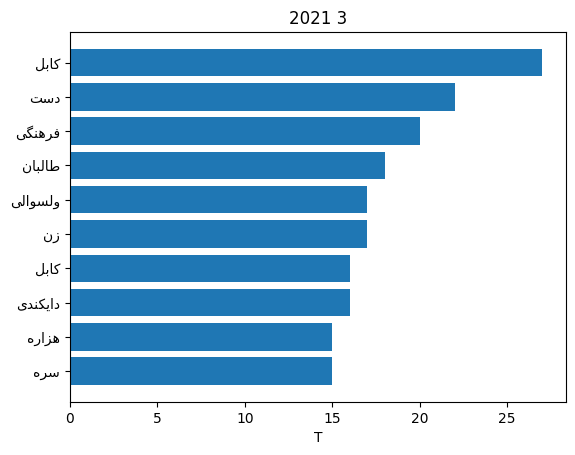

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import arabic_reshaper
from bidi.algorithm import get_display
# Fixing random state for reproducibility


plt.rcdefaults()
fig, ax = plt.subplots()

# Example data
n_words = 10
month = 14
# people = [get_display(arabic_reshaper.reshape(w)) for w in freq_words[50*month:50*month+n_words]]
people = [get_display(arabic_reshaper.reshape(w)) for w in freq_words[n_words*month:n_words*month+n_words]]
print(freq_words[n_words*month:n_words*month+n_words])
y_pos = np.arange(len(people))
performance = freq_cnt[n_words*month:n_words*month+n_words]
# error = np.random.rand(len(people))

ax.barh(y_pos, performance, align='center')
ax.set_yticks(y_pos)
ax.set_yticklabels(people)
ax.invert_yaxis()  # labels read top-to-bottom
ax.set_xlabel('T')
ax.set_title('202' + ('0' if month < 12 else '1') + ' ' + ('0' if month < 10 else '') + str((month%12)+1))

plt.show()

In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
sns.set_theme(style="white", rc={"axes.facecolor": (0, 0, 0, 0)})

# Create the data
g = np.tile(list("ABCDEFGHIJ"), 50)
df = pd.DataFrame(dict(x=x, g=g))
# m = df.g.map(ord)

# Initialize the FacetGrid object
pal = sns.cubehelix_palette(10, rot=-.25, light=.7)
g = sns.FacetGrid(df, row="g", hue="g", aspect=15, height=.5, palette=pal)

# Draw the densities in a few steps
g.map(sns.kdeplot, "x",
      bw_adjust=.5, clip_on=False,
      fill=True, alpha=1, linewidth=1.5)
g.map(sns.kdeplot, "x", clip_on=False, color="w", lw=2, bw_adjust=.5)

# passing color=None to refline() uses the hue mapping
g.refline(y=0, linewidth=2, linestyle="-", color=None, clip_on=False)


# Define and use a simple function to label the plot in axes coordinates
def label(x, color, label):
    ax = plt.gca()
    ax.text(0, .2, label, fontweight="bold", color=color,
            ha="left", va="center", transform=ax.transAxes)


g.map(label, "x")

# Set the subplots to overlap
g.figure.subplots_adjust(hspace=-.25)

# Remove axes details that don't play well with overlap
g.set_titles("")
g.set(yticks=[], ylabel="")
g.despine(bottom=True, left=True)

NameError: ignored

In [ ]:
df.groupby('lang', sort=True).size()

lang
ar     1022 
ca     12   
ckb    3    
cy     1    
da     1    
de     2    
el     1    
en     182  
es     1    
et     2    
fa     14619
fr     5    
ht     2    
in     38   
it     2    
ja     5    
ps     1637 
ro     1    
sd     4    
sv     1    
tl     2    
tr     3    
und    322  
ur     624  
dtype: int64

In [ ]:
df[df.mid.isin(ind2.inverted_index[hash('طالبان')])].groupby('daykey', sort=True).size().plot()#.sort_values(ascending=False)

KeyError: ignored

In [ ]:
df[df.mid.isin(ind2.inverted_index[hash('طالبان')])].groupby('daykey', sort=True).size().plot()#.sort_values(ascending=False)

KeyError: ignored

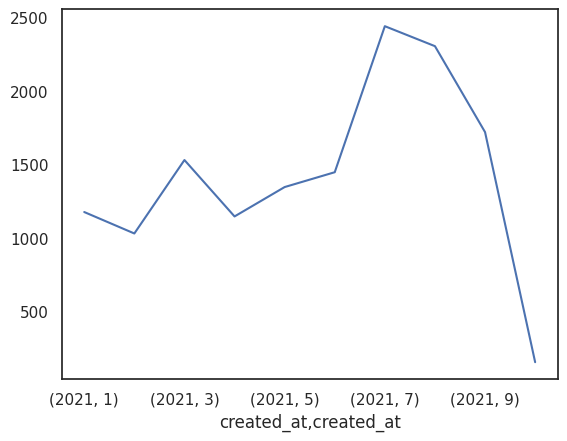

In [ ]:
df[df.created_at.dt.year == 2021].groupby(by=[df.created_at.dt.year, df.created_at.dt.month], sort=True).size().plot()#figsize=(15, 5), xticks=range(15))

/usr/local/lib/python3.7/dist-packages/pandas/core/ops/array_ops.py:73: FutureWarning: Comparison of Timestamp with datetime.date is deprecated in order to match the standard library behavior.  In a future version these will be considered non-comparable.Use 'ts == pd.Timestamp(date)' or 'ts.date() == date' instead.
  result = libops.scalar_compare(x.ravel(), y, op)


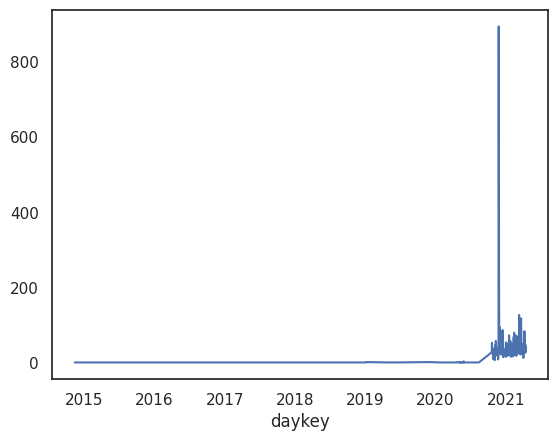

In [ ]:
df[df.daykey < pd.to_datetime('2021-04-14')].groupby('daykey', sort=True).size().plot()

In [ ]:
df.retweet_count.sort_values()

In [ ]:
df[df.daykey < pd.to_datetime('2021-04-14')].groupby('daykey', sort=True).sum()

In [ ]:
df.words

In [ ]:
from hazm import word_tokenize
import pandas as pd

import gensim
from gensim.models.word2vec import Word2Vec


# reading dataset
# df = pd.read_csv('data/cleaned/data.csv')
# df.title = df.title.apply(str)
# df.comment = df.comment.apply(str)

# # Storing comments in list
words = [word for word in df[df.created_at.dt.year == 2021][df.created_at.dt.month > 5].words]

# # converting each sentence to list of words and inserting in sents
# sents = [word_tokenize(comment) for comment in comments]

model = Word2Vec(sentences=words, size=64, window=10, min_count=5, seed=42, workers=5)
model.most_similar('طالبان')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:20: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('شده است', 0.9626750946044922),
 ('تروریست', 0.9572200179100037),
 ('گفتنی', 0.9547778367996216),
 ('نقل', 0.9546154141426086),
 ('مبنی', 0.9533365368843079),
 ('مدعی', 0.9505747556686401),
 ('ساخته شد', 0.9476068019866943),
 ('نامعلوم', 0.9470088481903076),
 ('گزارش', 0.946677565574646),
 ('کرده اند', 0.9463474750518799)]

In [ ]:
ind2 = IndexMaker()
ind2.run(df[df.retweet_count > 1])
freq_words2 = [f[1] for f in ind2.sorted_dictionary[:50]]
freq_cnt2 = [f[0] for f in ind2.sorted_dictionary[:50]]
print(freq_words2)

['طالبان', 'ولسوالی', 'کابل', 'هزاره', 'نیرو', 'والی', 'بودا', 'مین', 'مزار', 'پنجشیر', 'علی', 'امنیتی', 'زیبا', 'دست', 'سیغان', 'دایکندی', 'انفجار', 'هرات', 'تن', 'کهمرد', 'زن', 'in', 'کشور', 'تخریب', 'بهسود', 'ایران', 'امیر', 'الله', 'مجسمه', 'عکس', 'میدان', 'حمله', 'شهید', 'کر', 'طالب', 'مقاومت', 'حکومت', 'پر', 'مجاهد', 'سی', 'گروه', 'تروریست', 'دختر', 'بلخ', 'یی', 'کشید&کش', 'ولایه', 'فتح', 'شده است', 'جان']


## Word2Vec


In [ ]:
keys = ['تخریب', 'ایران', 'مجسمه', 'حمله', 'تروریست', 'طالب', 'دختر', 'کشید&کش', 'فتح', 'طالبان']
# keys = ['قندهار', 'پنجشیر', 'کابل', 'وردک', 'هزاره', 'هرات', 'ایران', 'یکاولنگ', 'بلخ', 'بندامیر', 'دایکندی', 'بدخشان', 'بهسود', 'بهسود', 'غزنی', 'سیغان', 'کهمرد', 'بلخ']
# keys = ['علی', 'مزار', 'هاشم', 'علیپور']

# keys = freq_words2[:10]
keys2 = [get_display(arabic_reshaper.reshape(w)) for w in keys]

embedding_clusters = []
word_clusters = []
for word in keys:
    embeddings = []
    words = []
    for similar_word, _ in model.most_similar(word, topn=30):
        words.append(get_display(arabic_reshaper.reshape(similar_word)))
        embeddings.append(model[similar_word])
    embedding_clusters.append(embeddings)
    word_clusters.append(words)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:13: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  del sys.path[0]
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:15: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  from ipykernel import kernelapp as app


In [ ]:
from sklearn.manifold import TSNE



In [ ]:
import matplotlib.pyplot as plt
import matplotlib.cm as cm
% matplotlib inline


def tsne_plot_similar_words(title, labels, embedding_clusters, word_clusters, a, filename=None):
    plt.figure(figsize=(16, 9))
    colors = cm.rainbow(np.linspace(0, 1, len(labels)))
    for label, embeddings, words, color in zip(labels, embedding_clusters, word_clusters, colors):
        x = embeddings[:, 0]
        y = embeddings[:, 1]
        plt.scatter(x, y, c=color, alpha=a, label=label)
        for i, word in enumerate(words):
            plt.annotate(word, alpha=0.5, xy=(x[i], y[i]), xytext=(5, 2),
                         textcoords='offset points', ha='right', va='bottom', size=8)
    plt.legend(loc=4)
    plt.title(title)
    plt.grid(True)
    if filename:
        plt.savefig(filename, format='png', dpi=150, bbox_inches='tight')
    plt.show()


/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:986: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  FutureWarning,
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you inte

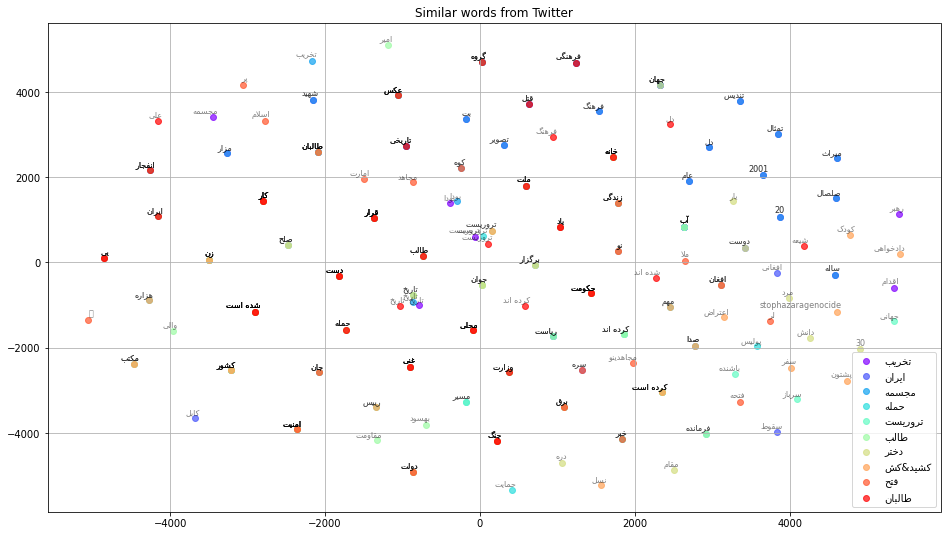

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:986: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  FutureWarning,
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you inte

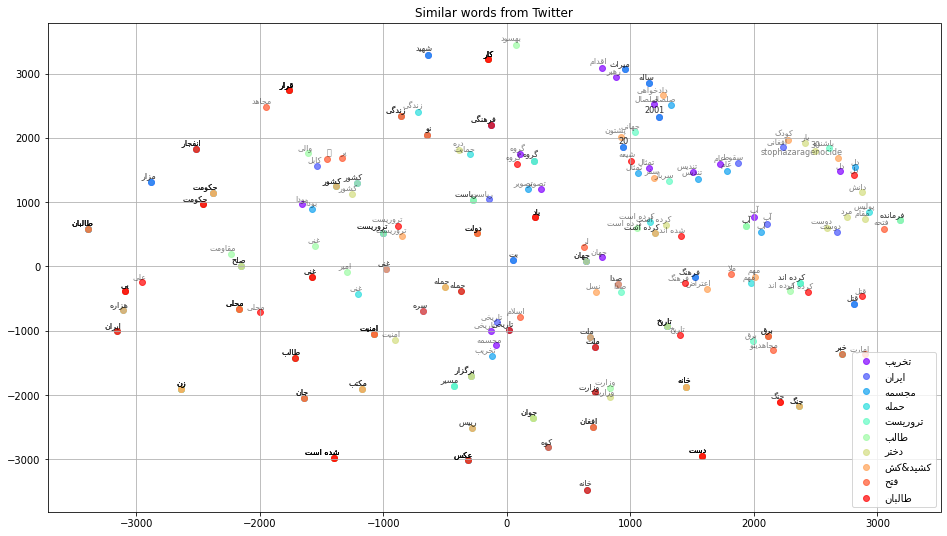

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:986: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  FutureWarning,
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you inte

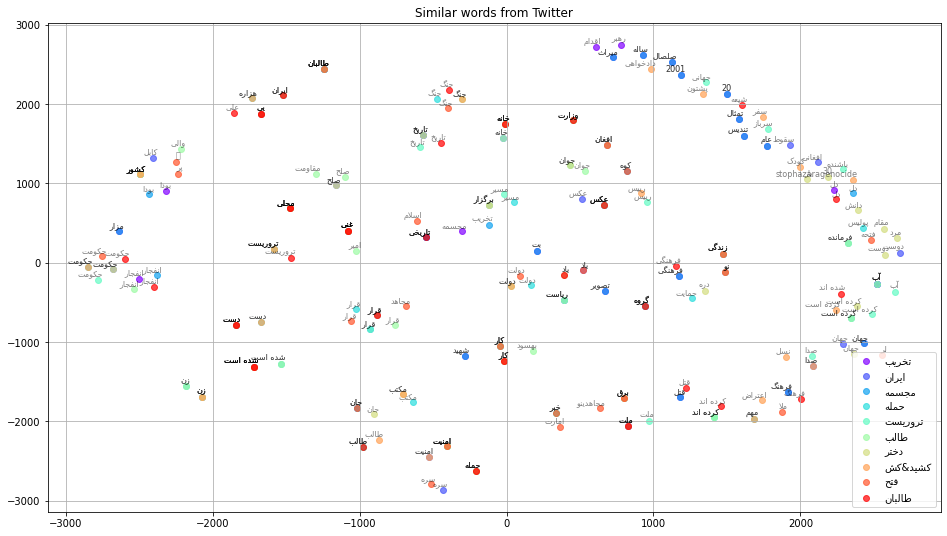

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:986: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  FutureWarning,
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you inte

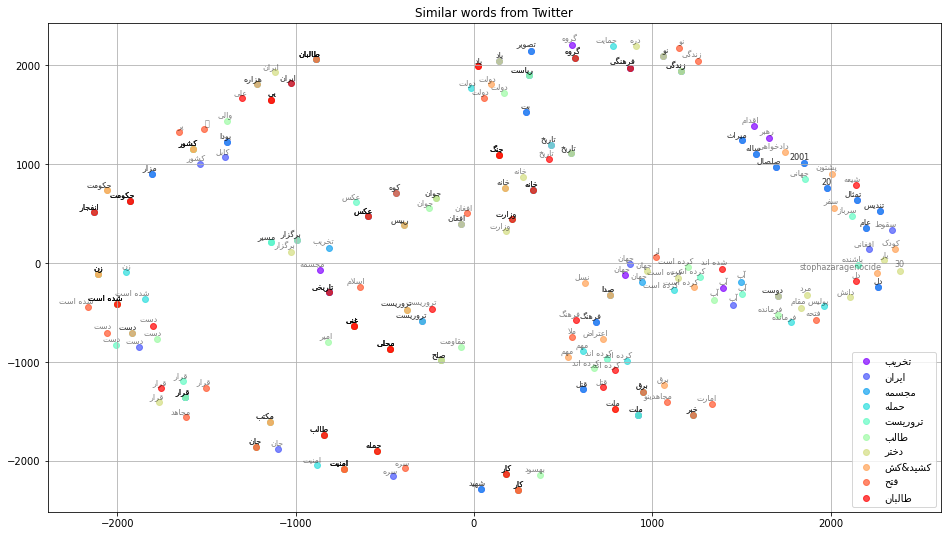

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:986: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  FutureWarning,
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you inte

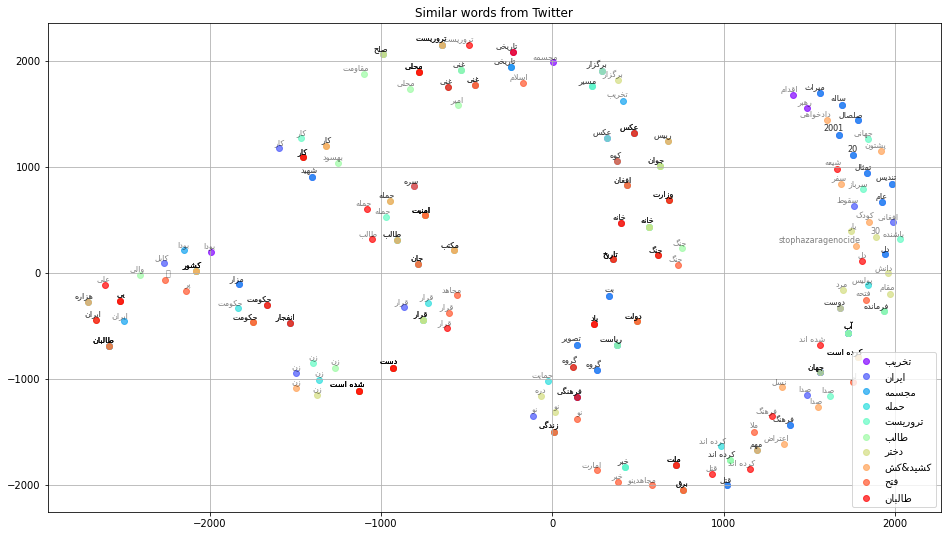

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:986: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  FutureWarning,
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you inte

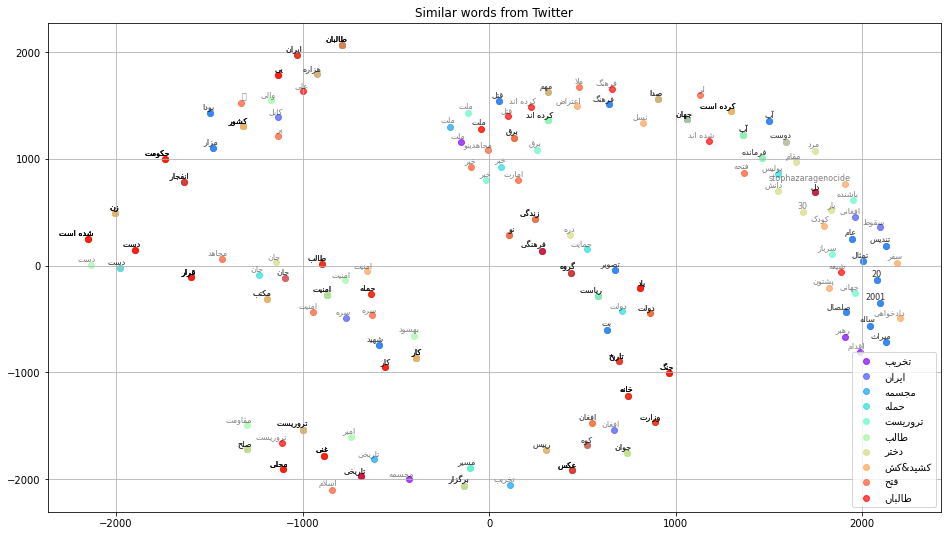

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:986: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  FutureWarning,
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you inte

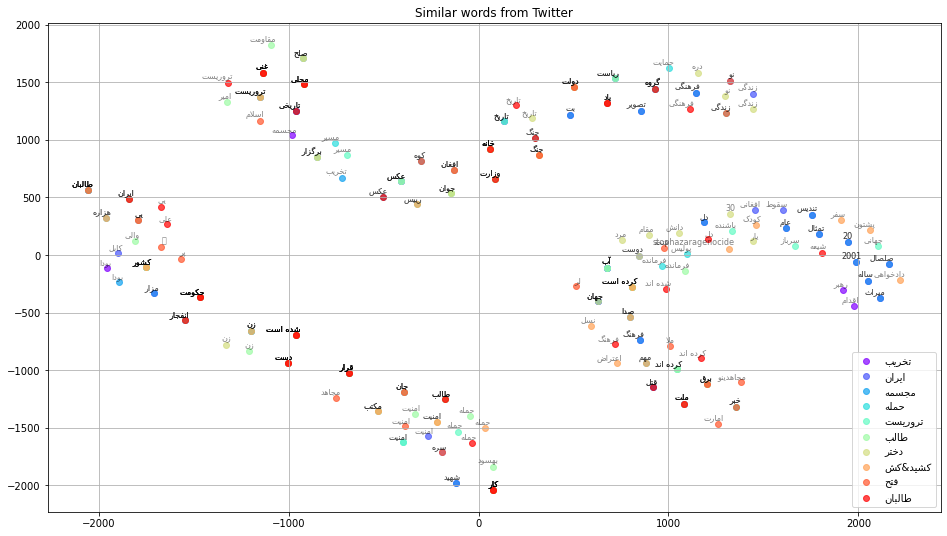

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:986: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  FutureWarning,
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you inte

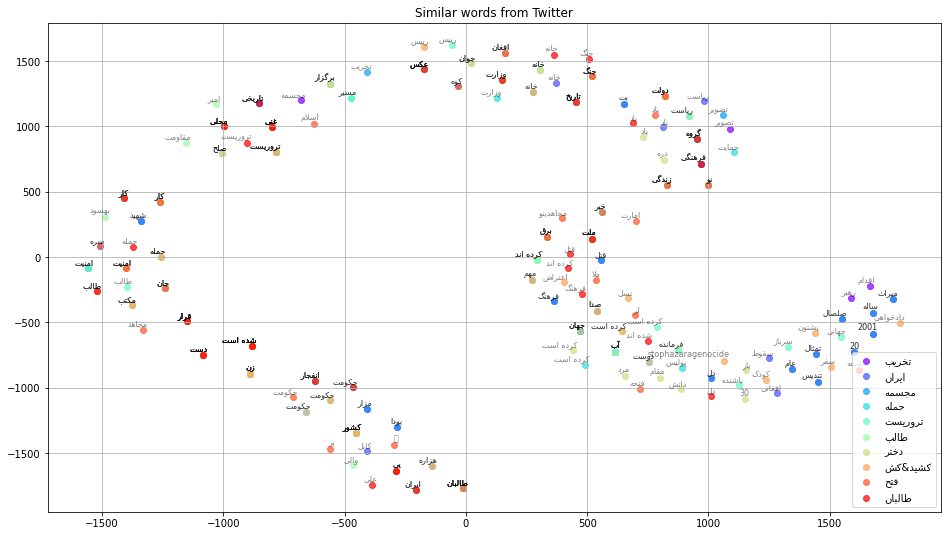

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:986: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  FutureWarning,
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you inte

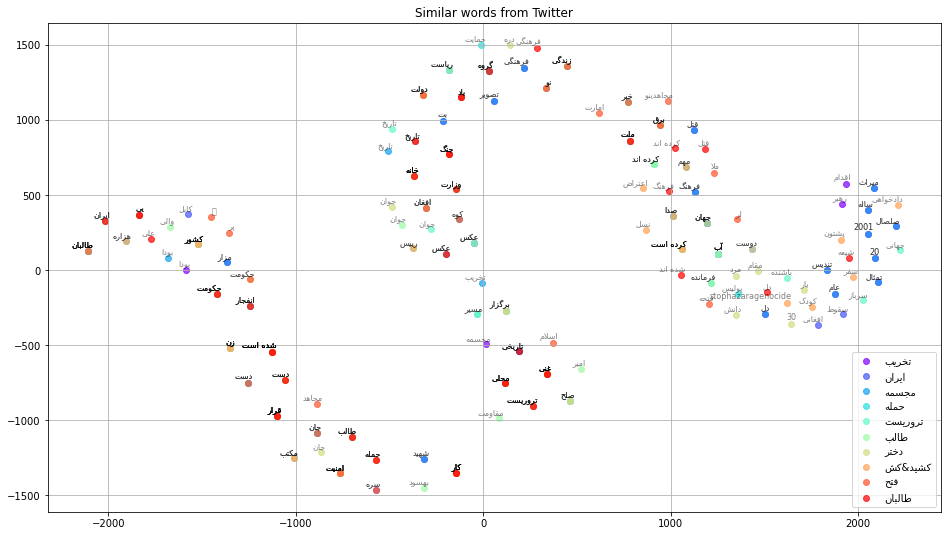

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:986: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  FutureWarning,
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you inte

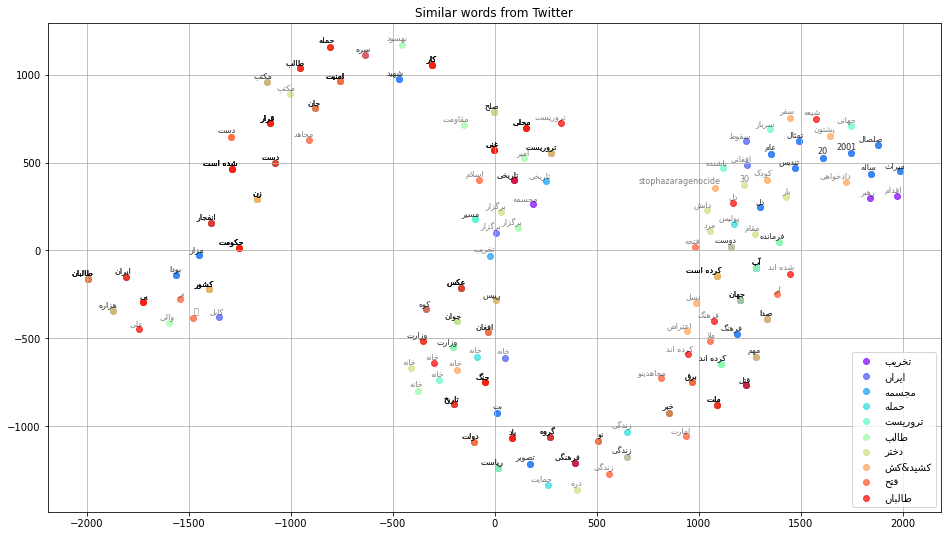

In [ ]:
for i in range(10):
  tsne_model_en_2d = TSNE(perplexity=i*5, n_components=2, init='pca', n_iter=3500, random_state=32)
  embedding_clusters = np.array(embedding_clusters)
  n, m, k = embedding_clusters.shape
  embeddings_en_2d = np.array(tsne_model_en_2d.fit_transform(embedding_clusters.reshape(n * m, k))).reshape(n, m, 2)
  tsne_plot_similar_words('Similar words from Twitter', keys2, embeddings_en_2d, word_clusters, 0.7,
                          'similar_words2_{}.png'.format(i))

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:986: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  FutureWarning,
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you inte

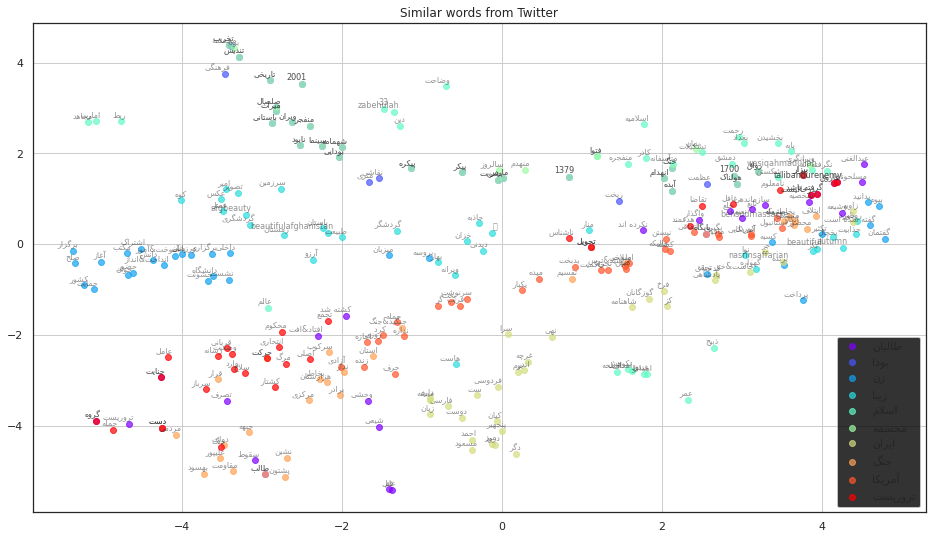

In [ ]:
tsne_model_en_2d = TSNE(perplexity=100, n_components=2, init='pca', n_iter=3500, random_state=32)
embedding_clusters = np.array(embedding_clusters)
n, m, k = embedding_clusters.shape
embeddings_en_2d = np.array(tsne_model_en_2d.fit_transform(embedding_clusters.reshape(n * m, k))).reshape(n, m, 2)
tsne_plot_similar_words('Similar words from Twitter', keys2, embeddings_en_2d, word_clusters, 0.7,
                        'similar_words2_{}.png'.format(10))

In [ ]:
model.similar_by_word('بامیان')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `similar_by_word` (Method will be removed in 4.0.0, use self.wv.similar_by_word() instead).
  """Entry point for launching an IPython kernel.


KeyError: ignored

In [ ]:
from hazm import word_tokenize
import pandas as pd

import gensim
from gensim.models.word2vec import Word2Vec

models = []
for j in range(10):
  words = [word for word in df[df.created_at.dt.year == 2021][df.created_at.dt.month == j+1].words]
  models.append(Word2Vec(sentences=words, size=64, window=10, min_count=5, seed=42, workers=5))

In [ ]:
reg = []
gan = []
for j in range(10):
  f = models[j].similar_by_word('طالبان')
  r = [get_display(arabic_reshaper.reshape(ff[0])) for ff in f]
  g = [ff[1] for ff in f]
  reg.append(r)
  gan.append(g)

In [ ]:
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

from matplotlib.cm import ScalarMappable
from matplotlib.lines import Line2D
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from textwrap import wrap

In [ ]:
def plot_radar(wor, sim, n, filename=None):
  ANGLES = np.linspace(1 / n / 2, 2 * np.pi - (1 / n / 2), n, endpoint=False)
  LENGTHS = sim
  MEAN_GAIN = sim
  REGION = wor
  TRACKS_N = sim

  GREY12 = "#1f1f1f"
  plt.rcParams.update({"font.family": "Bell MT"})
  plt.rcParams["text.color"] = GREY12
  plt.rc("axes", unicode_minus=False)
  COLORS = ["#6C5B7B","#C06C84","#F67280","#F8B195"]
  cmap = mpl.colors.LinearSegmentedColormap.from_list("my color", COLORS, N=256)
  norm = mpl.colors.Normalize(vmin=min(TRACKS_N), vmax=max(TRACKS_N))
  COLORS = cmap(norm(TRACKS_N))
  fig, ax = plt.subplots(figsize=(9, 12.6), subplot_kw={"projection": "polar"})
  fig.patch.set_facecolor("white")
  ax.set_facecolor("white")
  ax.set_theta_offset(1.2 * np.pi / 2)
  ax.bar(ANGLES, LENGTHS, color=COLORS, alpha=0.9, width=1 / n * 5, zorder=n)
  ax.vlines(ANGLES, 0, 1, color=GREY12, ls=(0, (4, 4)), zorder=n+1)
  ax.scatter(ANGLES, MEAN_GAIN, s=60, color=GREY12, zorder=n+1)

  REGION = ["\n".join(wrap(r, 5, break_long_words=False)) for r in REGION]
  ax.set_xticks(ANGLES)
  ax.set_xticklabels(REGION, size=12)
  if filename:
        plt.savefig(filename, format='png', dpi=150, bbox_inches='tight')

In [ ]:
n = 30
f = model.similar_by_vector(model['اسلام'], topn=n)
r = [get_display(arabic_reshaper.reshape(ff[0])) for ff in f]
g = [ff[1] for ff in f]
plot_radar(r, g, n, 'islam.png')

In [ ]:
for w, s in zip(reg, gan):
  plot_radar(w, s)

In [ ]:
model.wv.save_word2vec_format('w2c.tsv')

In [ ]:
f = open('w2c.tsv', 'r')